In [12]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df_data=pd.read_csv('breast-cancer.csv')

df_data.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [4]:
df_data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [5]:
df_data = df_data.drop(["id"], axis = 1)
df_data.diagnosis.replace(["M", "B"], [1, 0], inplace = True)


In [6]:
df_data.duplicated().sum()


0

In [7]:
display(df_data.describe())


,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,0.372583,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,0.483918,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,0.000000,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,0.000000,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,0.000000,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,1.000000,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,1.000000,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [7]:
df_data.isnull().values.any()

False

In [8]:
df_data.corr()


,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
diagnosis,1.000000,0.730029,0.415185,0.742636,0.708984,0.358560,0.596534,0.696360,0.776614,0.330499,...,0.776454,0.456903,0.782914,0.733825,0.421465,0.590998,0.659610,0.793566,0.416294,0.323872
radius_mean,0.730029,1.000000,0.323782,0.997855,0.987357,0.170581,0.506124,0.676764,0.822529,0.147741,...,0.969539,0.297008,0.965137,0.941082,0.119616,0.413463,0.526911,0.744214,0.163953,0.007066
texture_mean,0.415185,0.323782,1.000000,0.329533,0.321086,-0.023389,0.236702,0.302418,0.293464,0.071401,...,0.352573,0.912045,0.358040,0.343546,0.077503,0.277830,0.301025,0.295316,0.105008,0.119205
perimeter_mean,0.742636,0.997855,0.329533,1.000000,0.986507,0.207278,0.556936,0.716136,0.850977,0.183027,...,0.969476,0.303038,0.970387,0.941550,0.150549,0.455774,0.563879,0.771241,0.189115,0.051019
area_mean,0.708984,0.987357,0.321086,0.986507,1.000000,0.177028,0.498502,0.685983,0.823269,0.151293,...,0.962746,0.287489,0.959120,0.959213,0.123523,0.390410,0.512606,0.722017,0.143570,0.003738
smoothness_mean,0.358560,0.170581,-0.023389,0.207278,0.177028,1.000000,0.659123,0.521984,0.553695,0.557775,...,0.213120,0.036072,0.238853,0.206718,0.805324,0.472468,0.434926,0.503053,0.394309,0.499316
compactness_mean,0.596534,0.506124,0.236702,0.556936,0.498502,0.659123,1.000000,0.883121,0.831135,0.602641,...,0.535315,0.248133,0.590210,0.509604,0.565541,0.865809,0.816275,0.815573,0.510223,0.687382
concavity_mean,0.696360,0.676764,0.302418,0.716136,0.685983,0.521984,0.883121,1.000000,0.921391,0.500667,...,0.688236,0.299879,0.729565,0.675987,0.448822,0.754968,0.884103,0.861323,0.409464,0.514930
concave points_mean,0.776614,0.822529,0.293464,0.850977,0.823269,0.553695,0.831135,0.921391,1.000000,0.462497,...,0.830318,0.292752,0.855923,0.809630,0.452753,0.667454,0.752399,0.910155,0.375744,0.368661
symmetry_mean,0.330499,0.147741,0.071401,0.183027,0.151293,0.557775,0.602641,0.500667,0.462497,1.000000,...,0.185728,0.090651,0.219169,0.177193,0.426675,0.473200,0.433721,0.430297,0.699826,0.438413


<AxesSubplot:>

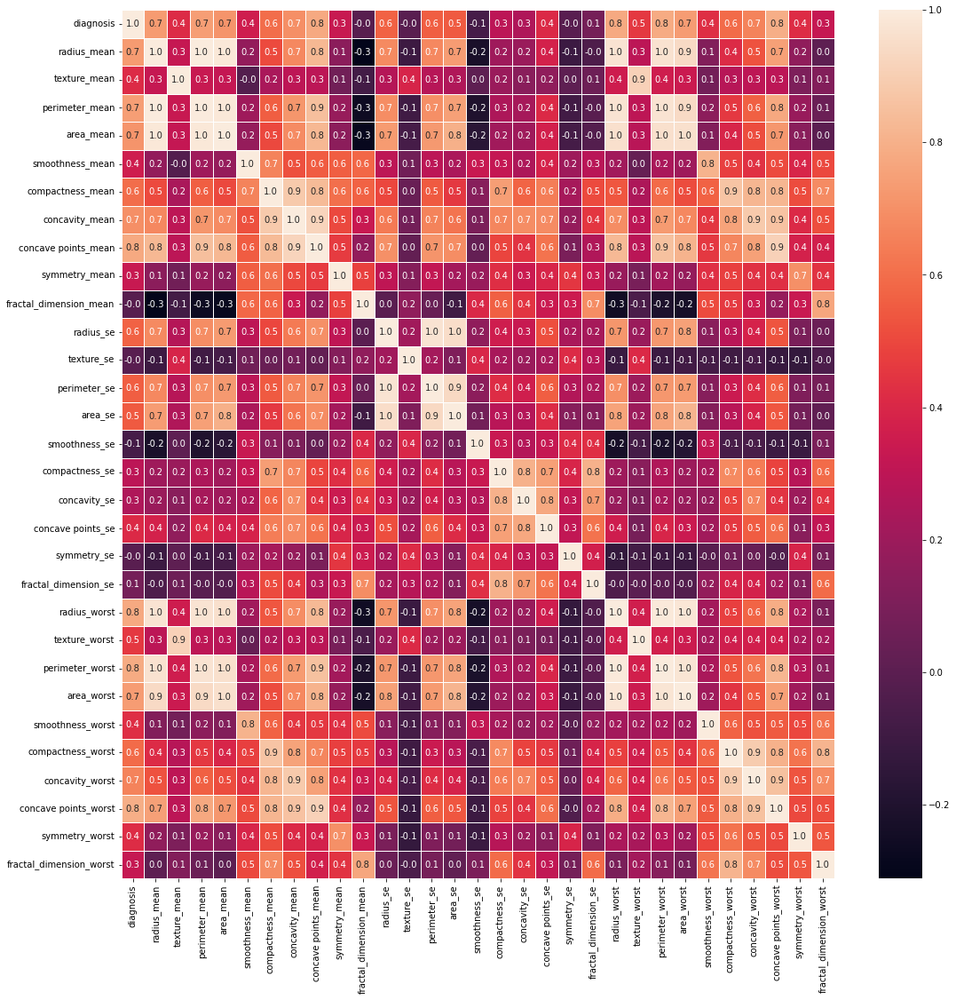

In [8]:
f,ax = plt.subplots(figsize=(18, 18))
sns.heatmap(df_data.corr(), annot=True, linewidths=.5, fmt= '.1f',ax=ax)

In [9]:
corr = df_data.corr()
corr.sort_values(['diagnosis'], ascending = False, inplace = True)
corr.diagnosis

diagnosis                  1.000000
concave points_worst       0.793566
perimeter_worst            0.782914
concave points_mean        0.776614
radius_worst               0.776454
perimeter_mean             0.742636
area_worst                 0.733825
radius_mean                0.730029
area_mean                  0.708984
concavity_mean             0.696360
concavity_worst            0.659610
compactness_mean           0.596534
compactness_worst          0.590998
radius_se                  0.567134
perimeter_se               0.556141
area_se                    0.548236
texture_worst              0.456903
smoothness_worst           0.421465
symmetry_worst             0.416294
texture_mean               0.415185
concave points_se          0.408042
smoothness_mean            0.358560
symmetry_mean              0.330499
fractal_dimension_worst    0.323872
compactness_se             0.292999
concavity_se               0.253730
fractal_dimension_se       0.077972
symmetry_se               -0

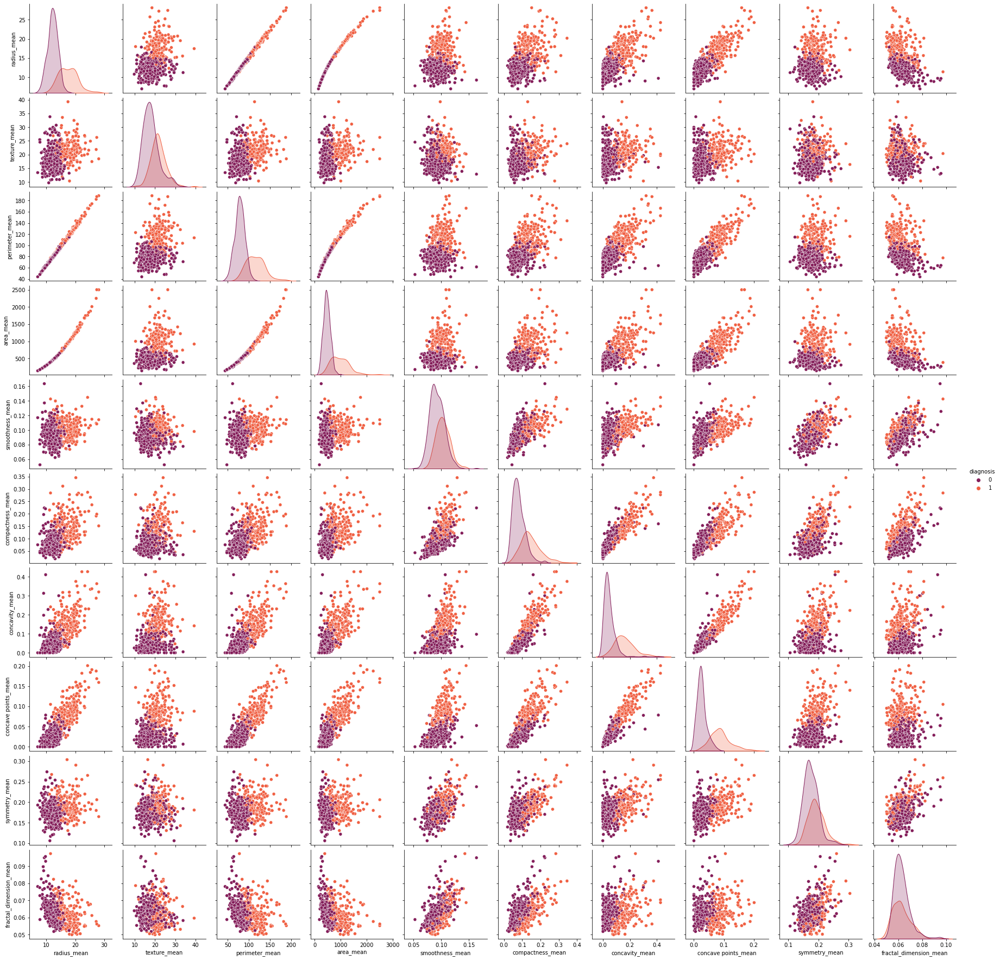

In [45]:
#visualizing the relation between the "mean" columns
cols = ["diagnosis",
        "radius_mean",
        "texture_mean",
        "perimeter_mean",
        "area_mean",
        "smoothness_mean",
        "compactness_mean",
        "concavity_mean",
        "concave points_mean",
        "symmetry_mean",
        "fractal_dimension_mean"]
sns.pairplot(data = df_data[cols], hue = "diagnosis", palette = "rocket")

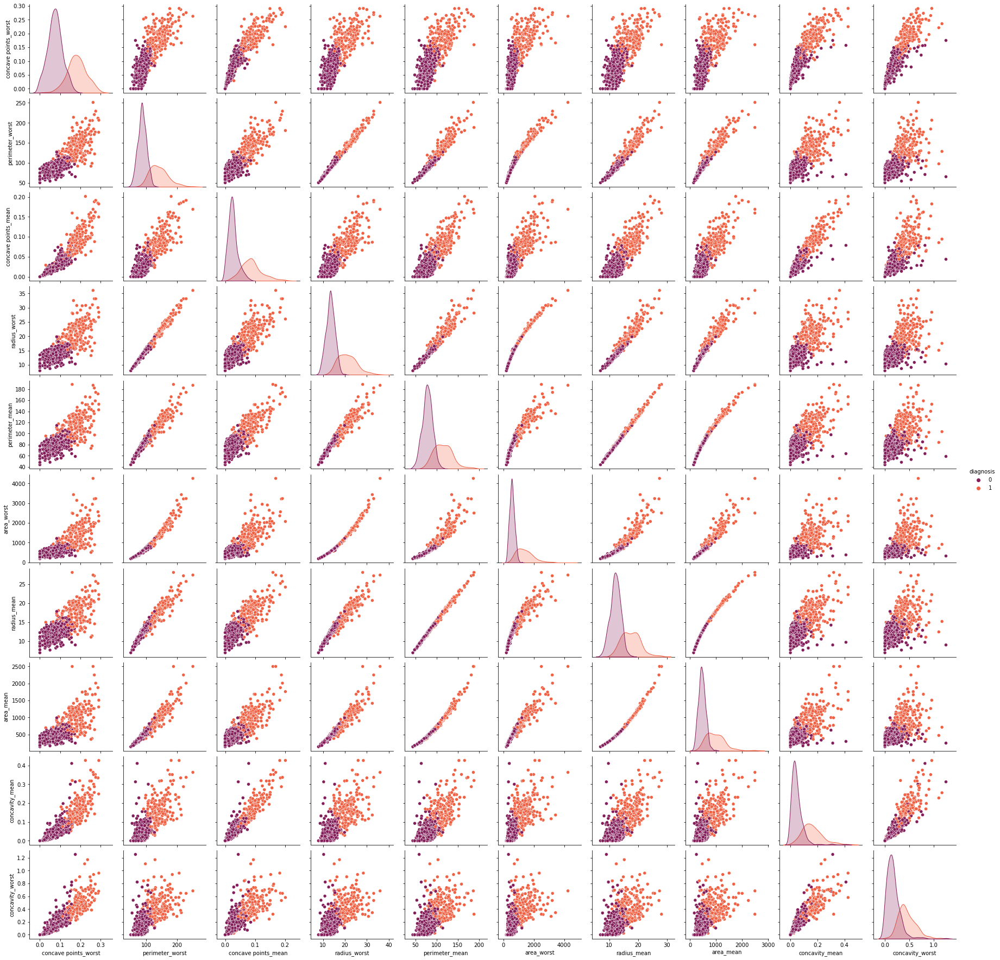

In [46]:
cols = ["diagnosis",
        "concave points_worst",
"perimeter_worst",
"concave_points_mean",
"radius_worst",
"perimeter_mean",
"area_worst",
"radius_mean",
"area_mean",
"concavity_mean",
"concavity_worst"]
sns.pairplot(data = df_data[cols], hue = "diagnosis", palette = "rocket")

In [10]:
features=df_data[['concave points_worst','perimeter_worst','concave points_mean','radius_worst','perimeter_mean','area_worst','radius_mean','area_mean','concavity_mean','concavity_worst','compactness_mean','compactness_worst','radius_se','perimeter_se','area_se','texture_worst','smoothness_worst','symmetry_worst','texture_mean','concave points_se','smoothness_mean','symmetry_mean','fractal_dimension_worst','compactness_se','concavity_se','fractal_dimension_se','symmetry_se','texture_se','fractal_dimension_mean','smoothness_se']]
diagnosis = df_data[["diagnosis"]]

Random Forest

In [13]:
from sklearn.feature_selection import RFECV
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler


In [14]:
x_train, x_test, y_train, y_test = train_test_split(features, diagnosis, test_size=0.3, random_state=42)

In [15]:
scaler = StandardScaler()
scaler.fit(x_train)
x_train = scaler.transform(x_train)
x_train = pd.DataFrame(x_train, columns = features.columns)

In [16]:
clf = RandomForestClassifier() 
rfecv = RFECV(estimator=clf, step=1, cv=5,scoring='accuracy')
rfecv = rfecv.fit(x_train, y_train.values.flatten())
print('Optimal number of features :', rfecv.n_features_)
print('Best features :', x_train.columns[rfecv.support_])

Optimal number of features : 16
Best features : Index(['concave points_worst', 'perimeter_worst', 'concave points_mean',
       'radius_worst', 'perimeter_mean', 'area_worst', 'area_mean',
       'concavity_mean', 'concavity_worst', 'compactness_worst', 'radius_se',
       'perimeter_se', 'area_se', 'texture_worst', 'symmetry_worst',
       'texture_mean'],
      dtype='object')


In [17]:
features_rf = df_data[["radius_mean", "texture_mean", "perimeter_mean", "area_mean", "concavity_mean", "concave points_mean", "radius_se", "area_se", 
                    "radius_worst", "texture_worst", "perimeter_worst", "area_worst", "smoothness_worst", "compactness_worst", "concavity_worst", "concave points_worst", "symmetry_worst"]]

In [18]:
x_train_rf, x_test_rf, y_train_rf, y_test_rf = train_test_split(features_rf,   
    diagnosis, test_size=0.30, random_state=42)

In [19]:
from sklearn.metrics import accuracy_score,precision_score

In [20]:
clf_rf = clf.fit(x_train_rf, y_train_rf.values.flatten())
ac_rfecv_rf = accuracy_score(y_test_rf, clf_rf.predict(x_test_rf))
pre_rfecv_rf = precision_score(y_test_rf, clf_rf.predict(x_test_rf))
print("Accuracy Score", ac_rfecv_rf)
print("Precision Score", pre_rfecv_rf)

Accuracy Score 0.9649122807017544
Precision Score 0.9672131147540983


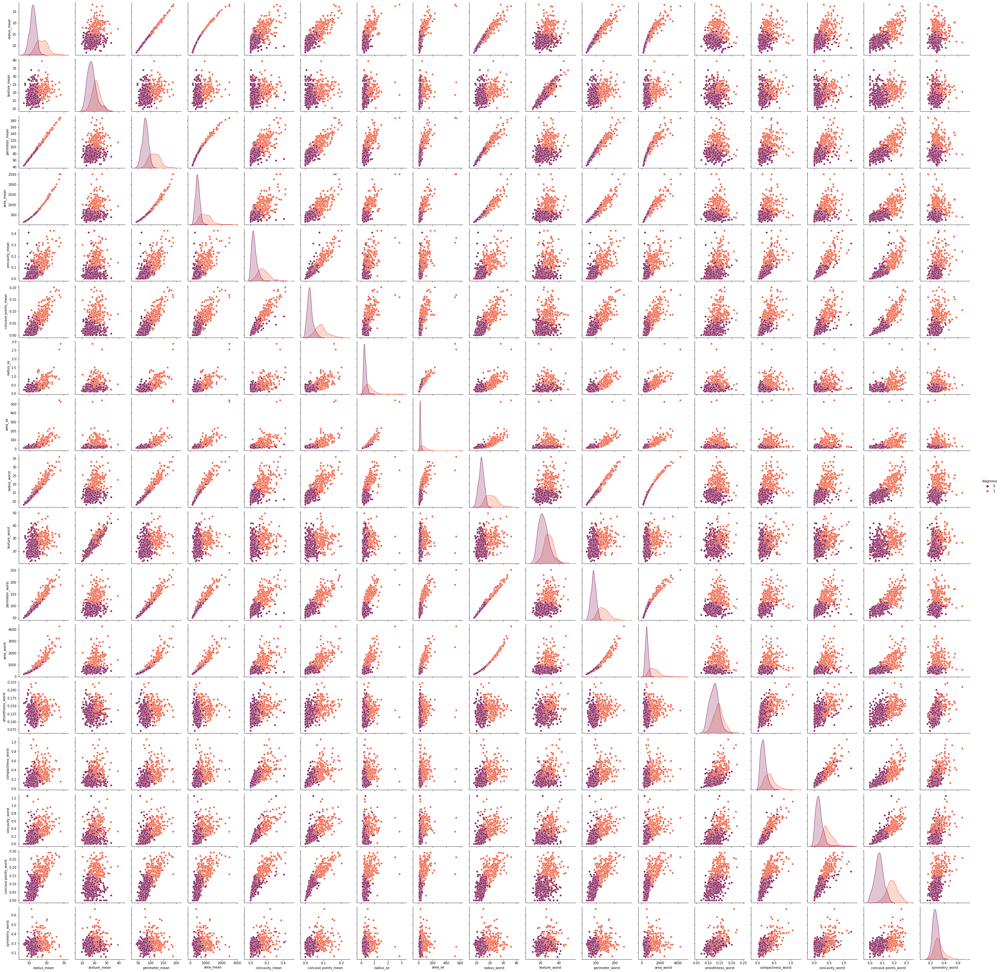

In [42]:
cols = ["diagnosis","radius_mean", "texture_mean", "perimeter_mean", "area_mean", "concavity_mean", "concave points_mean", "radius_se", "area_se", 
                    "radius_worst", "texture_worst", "perimeter_worst", "area_worst", "smoothness_worst", "compactness_worst", "concavity_worst", "concave points_worst", "symmetry_worst"]
sns.pairplot(data = df_data[cols], hue = "diagnosis", palette = "rocket")

Logistic Regression

In [21]:
from sklearn.linear_model import LogisticRegression

In [22]:
clf_lr = LogisticRegression() 
rfecv_lr = RFECV(estimator=clf_lr, step=1, cv=5,scoring='accuracy')   #5-fold cross-validation
rfecv_lr = rfecv_lr.fit(x_train, y_train.values.flatten())

print('Optimal number of features :', rfecv_lr.n_features_)
print('Best features :', x_train.columns[rfecv_lr.support_])

Optimal number of features : 24
Best features : Index(['concave points_worst', 'perimeter_worst', 'concave points_mean',
       'radius_worst', 'perimeter_mean', 'area_worst', 'radius_mean',
       'area_mean', 'concavity_mean', 'concavity_worst', 'compactness_mean',
       'radius_se', 'perimeter_se', 'area_se', 'texture_worst',
       'smoothness_worst', 'symmetry_worst', 'texture_mean',
       'concave points_se', 'symmetry_mean', 'compactness_se',
       'fractal_dimension_se', 'symmetry_se', 'smoothness_se'],
      dtype='object')


In [23]:
features_lr = df_data[["radius_mean", "texture_mean", "perimeter_mean", "area_mean",
       "compactness_mean", "concavity_mean", "concave points_mean",
       "symmetry_mean", "radius_se", "perimeter_se", "area_se",
       "smoothness_se", "compactness_se", "concave points_se", "symmetry_se",
       "fractal_dimension_se", "radius_worst", "texture_worst",
       "perimeter_worst", "area_worst", "smoothness_worst", "concavity_worst",
       "concave points_worst", "symmetry_worst"]]

In [24]:
x_train_lr, x_test_lr, y_train_lr, y_test_lr = train_test_split(features_lr,   
    diagnosis, test_size=0.30, random_state=42)

In [25]:
clf_lr_2= clf_lr.fit(x_train_lr, y_train_lr.values.flatten())
ac_rfecv_lr = accuracy_score(y_test_lr, clf_lr_2.predict(x_test_lr))
pre_rfecv_lr = precision_score(y_test_lr, clf_lr_2.predict(x_test_lr))
print("Accuracy Score", ac_rfecv_lr)
print("Precision Score", pre_rfecv_lr)

Accuracy Score 0.9707602339181286
Precision Score 0.967741935483871


C:\Users\Predator\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Support Vector Machine

In [26]:
from sklearn.svm import SVC

In [27]:
clf_svm = SVC(kernel = "linear")
rfecv_svm = RFECV(estimator=clf_svm, step=1, cv=5,scoring='accuracy')   #5-fold cross-validation
rfecv_svm = rfecv_svm.fit(x_train, y_train.values.flatten())

print('Optimal number of features :', rfecv_svm.n_features_)
print('Best features :', x_train.columns[rfecv_svm.support_])

Optimal number of features : 29
Best features : Index(['concave points_worst', 'perimeter_worst', 'concave points_mean',
       'radius_worst', 'perimeter_mean', 'area_worst', 'radius_mean',
       'area_mean', 'concavity_mean', 'concavity_worst', 'compactness_mean',
       'compactness_worst', 'radius_se', 'perimeter_se', 'area_se',
       'texture_worst', 'smoothness_worst', 'symmetry_worst', 'texture_mean',
       'concave points_se', 'smoothness_mean', 'symmetry_mean',
       'fractal_dimension_worst', 'compactness_se', 'concavity_se',
       'fractal_dimension_se', 'symmetry_se', 'texture_se',
       'fractal_dimension_mean'],
      dtype='object')


In [28]:
features_svm = df_data[["radius_mean", "texture_mean", "perimeter_mean", "area_mean",
       "smoothness_mean", "compactness_mean", "concavity_mean",
       "concave points_mean", "symmetry_mean", "fractal_dimension_mean",
       "radius_se", "texture_se", "perimeter_se", "area_se", "compactness_se",
       "concavity_se", "concave points_se", "symmetry_se",
       "fractal_dimension_se", "radius_worst", "texture_worst",
       "perimeter_worst", "area_worst", "smoothness_worst",
       "compactness_worst", "concavity_worst", "concave points_worst",
       "symmetry_worst", "fractal_dimension_worst"]]

In [29]:
x_train_svm, x_test_svm, y_train_svm, y_test_svm = train_test_split(features_svm,   
    diagnosis, test_size=0.30, random_state=42)

In [30]:
clf_svm_2= clf_svm.fit(x_train_svm, y_train_svm.values.flatten())
ac_rfecv_svm = accuracy_score(y_test_svm, clf_svm_2.predict(x_test_svm))
pre_rfecv_svm = precision_score(y_test_svm, clf_svm_2.predict(x_test_svm))
print("Accuracy Score", ac_rfecv_svm)
print("Precision Score", pre_rfecv_svm)

Accuracy Score 0.9649122807017544
Precision Score 0.9672131147540983


Decision Tree


In [31]:
from sklearn.tree import DecisionTreeClassifier

In [32]:
clf_dt = DecisionTreeClassifier()
rfecv_dt = RFECV(estimator=clf_dt, step=1, cv=5,scoring='accuracy')   
rfecv_dt = rfecv_dt.fit(x_train, y_train.values.ravel())

print('Optimal number of features :', rfecv_dt.n_features_)
print('Best features :', x_train.columns[rfecv_dt.support_])

Optimal number of features : 4
Best features : Index(['concave points_mean', 'radius_worst', 'area_worst', 'texture_worst'], dtype='object')


In [33]:
features_dt = df_data[['concave points_mean', 'radius_worst', 'area_worst', 'radius_se',
       'texture_worst', 'concave points_se']]

In [34]:
x_train_dt, x_test_dt, y_train_dt, y_test_dt = train_test_split(features_dt,   
    diagnosis, test_size=0.30, random_state=42)

In [35]:
clf_dt_2= clf_dt.fit(x_train_dt, y_train_dt.values.flatten())
ac_rfecv_dt = accuracy_score(y_test_dt, clf_dt_2.predict(x_test_dt))
pre_rfecv_dt = precision_score(y_test_dt, clf_dt_2.predict(x_test_dt))
print("Accuracy Score", ac_rfecv_dt)
print("Precision Score", pre_rfecv_dt)

Accuracy Score 0.9532163742690059
Precision Score 0.9230769230769231


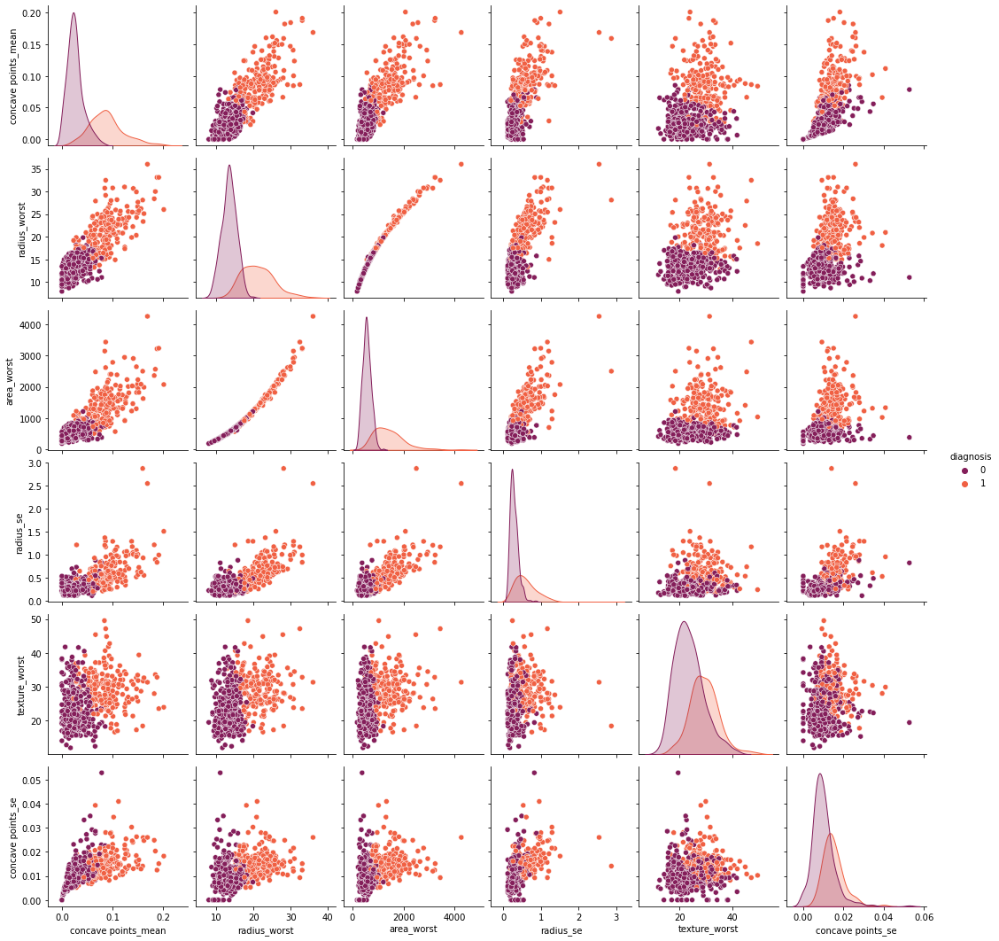

In [40]:
cols = ['diagnosis','concave points_mean', 'radius_worst', 'area_worst', 'radius_se',
       'texture_worst', 'concave points_se']
sns.pairplot(data = df_data[cols], hue = "diagnosis", palette = "rocket")

In [36]:
models_acc = pd.DataFrame({ "Classifier" : ["Logistic Regression", "Support Vector Machine", "Decision Tree", "Random Forest"], 
                       "Score" : [ac_rfecv_lr*100, ac_rfecv_svm*100, ac_rfecv_dt*100, ac_rfecv_rf*100]})
models_acc.sort_values(by = "Score", ascending = False)

,Classifier,Score
0,Logistic Regression,97.076023
1,Support Vector Machine,96.491228
3,Random Forest,96.491228
2,Decision Tree,95.321637


In [37]:
models_acc = pd.DataFrame({ "Classifier" : ["Logistic Regression", "Support Vector Machine", "Decision Tree", "Random Forest"], 
                       "Score" : [pre_rfecv_lr*100, pre_rfecv_svm*100, pre_rfecv_dt*100, pre_rfecv_rf*100]})
models_acc.sort_values(by = "Score", ascending = False)

,Classifier,Score
0,Logistic Regression,96.774194
1,Support Vector Machine,96.721311
3,Random Forest,96.721311
2,Decision Tree,92.307692


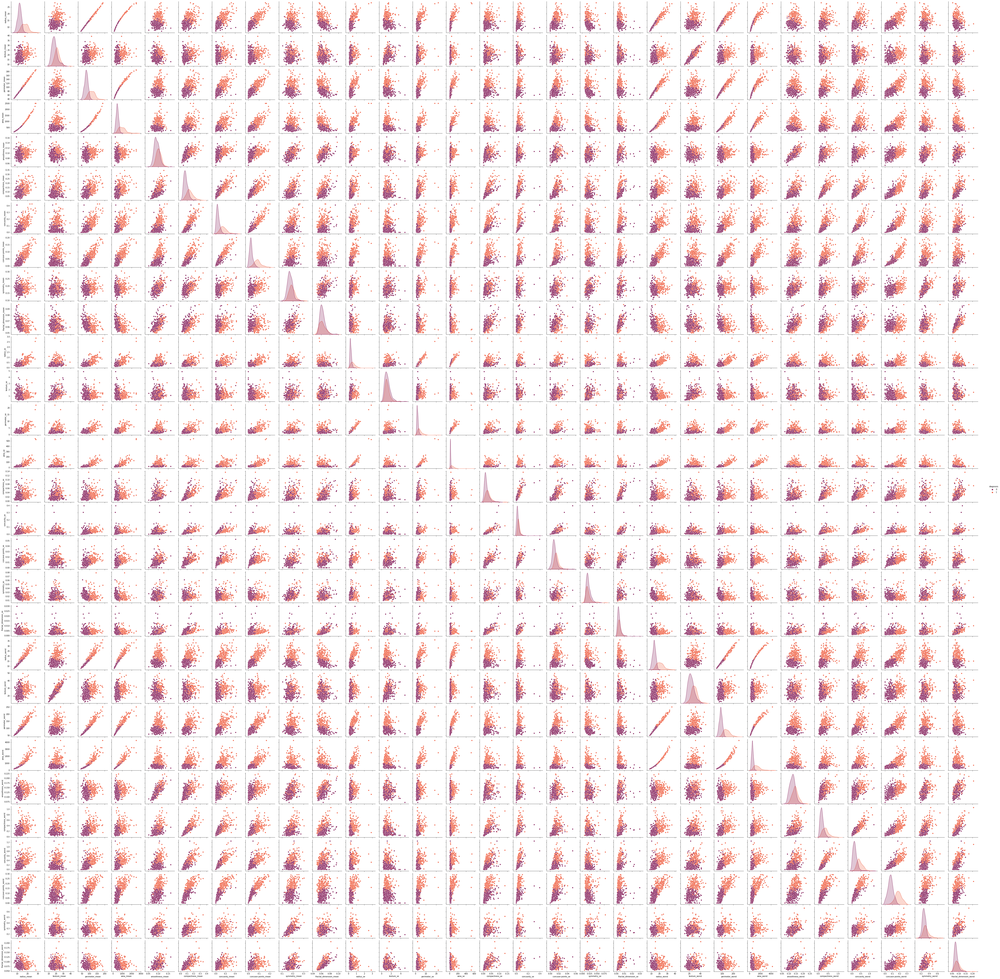

In [43]:
cols=["diagnosis","radius_mean", "texture_mean", "perimeter_mean", "area_mean",
       "smoothness_mean", "compactness_mean", "concavity_mean",
       "concave points_mean", "symmetry_mean", "fractal_dimension_mean",
       "radius_se", "texture_se", "perimeter_se", "area_se", "compactness_se",
       "concavity_se", "concave points_se", "symmetry_se",
       "fractal_dimension_se", "radius_worst", "texture_worst",
       "perimeter_worst", "area_worst", "smoothness_worst",
       "compactness_worst", "concavity_worst", "concave points_worst",
       "symmetry_worst", "fractal_dimension_worst"]
sns.pairplot(data = df_data[cols], hue = "diagnosis", palette = "rocket")

In [2]:
import pickle
print(pickle.__doc__)

Create portable serialized representations of Python objects.

See module copyreg for a mechanism for registering custom picklers.
See module pickletools source for extensive comments.

Classes:

    Pickler
    Unpickler

Functions:

    dump(object, file)
    dumps(object) -> string
    load(file) -> object
    loads(bytes) -> object

Misc variables:

    __version__
    format_version
    compatible_formats


